In [1]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

In [2]:
unemployment_df = pd.read_csv("https://storage.googleapis.com/cs163-seniorproject.appspot.com/dataset/unemployment_rate/unemployment_rate_clean.csv")
cpi_df = pd.read_csv("https://storage.googleapis.com/cs163-seniorproject.appspot.com/dataset/cpi_rate/cpi_rate_clean.csv")
income_df = pd.read_csv("https://storage.googleapis.com/cs163-seniorproject.appspot.com/dataset/income/income_clean.csv")
poverty_df = pd.read_csv("https://storage.googleapis.com/cs163-seniorproject.appspot.com/dataset/poverty/poverty_clean.csv")

In [3]:
monthly_df = pd.DataFrame({
    'Month': pd.date_range(start='2013-01-01', end='2023-12-01', freq='MS')
})
monthly_df['Year'] = monthly_df['Month'].dt.year

In [4]:
#add unemployment rate
unemployment_df['Month'] = pd.to_datetime(unemployment_df['Month'])
monthly_df = monthly_df.merge(unemployment_df, on='Month', how='left')

In [5]:
#add CPI
cpi_df['Month'] = pd.to_datetime(cpi_df['Month'])
monthly_df = monthly_df.merge(cpi_df, on='Month', how='left')
monthly_df['CPI'] = monthly_df['CPI'].interpolate(method='linear')  # linear method

In [6]:
# add income
monthly_df = monthly_df.merge(income_df, on='Year', how='left')

In [7]:
# add poverty
monthly_df = monthly_df.merge(poverty_df, on='Year', how='left')

In [8]:
# normalize all columns
scaler = MinMaxScaler()
monthly_df[['norm_unemp', 'norm_cpi', 'norm_income', 'norm_poverty']] = scaler.fit_transform(
    monthly_df[['Unemployment', 'CPI', 'Median_Household_Income', 'Poverty Rate (%)']]
)

In [9]:
monthly_df['Stress_Score'] = (
    monthly_df['norm_unemp'] +
    monthly_df['norm_poverty'] +
    monthly_df['norm_cpi'] -
    monthly_df['norm_income']
)

In [10]:
monthly_df['Stress_Score']

0           NaN
1      1.495146
2      1.476157
3      1.437751
4      1.434436
         ...   
127    0.408955
128    0.395246
129    0.410663
130    0.394337
131    0.387721
Name: Stress_Score, Length: 132, dtype: float64

In [11]:
monthly_df['Stress_Score'] = monthly_df['Stress_Score'].interpolate(method='linear') 

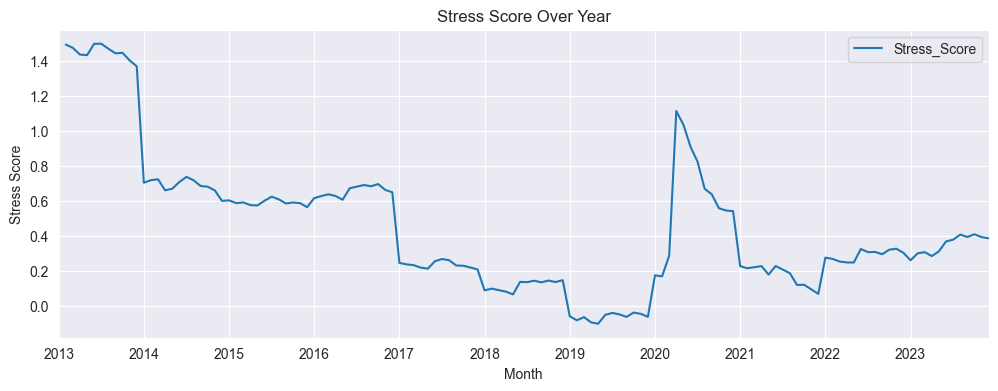

In [12]:
monthly_df.plot(x='Month', y='Stress_Score', figsize=(12, 4), title='Stress Score Over Year')
plt.ylabel('Stress Score')
plt.grid(True)
plt.show()

In [31]:
#merge 911 df
calls_df = pd.read_csv("https://storage.googleapis.com/cs163-seniorproject.appspot.com/dataset/911_calls/911_calls_clean.csv")
calls_df['Month'] = pd.to_datetime(calls_df['OFFENSE_DATE']).dt.to_period("M").dt.to_timestamp()
monthly_calls = calls_df.groupby("OFFENSE_DATE").size().reset_index(name="Call_Count")
monthly_calls = monthly_calls.rename(columns={'OFFENSE_DATE': 'Month'})
monthly_calls['Month'] = pd.to_datetime(monthly_calls['Month'])

In [32]:
final_df = monthly_calls.merge(monthly_df[['Month', 'Stress_Score']], on='Month', how='left')

In [33]:
final_df['Stress_Score'] = final_df['Stress_Score'].ffill()

In [40]:
final_df = final_df.rename(columns={'Month': 'Year'})

In [42]:
final_df = final_df[final_df['Year'] != 2024]

In [54]:
final_df['Month_Num'] = pd.to_datetime(final_df['Year']).dt.month

In [55]:
# Aggregate to one value per month per year
final_df = final_df.groupby(['Year', 'Month_Num']).agg({
    'Call_Count': 'mean',       
    'Stress_Score': 'mean'
}).reset_index()


In [56]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4377 entries, 0 to 4376
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Year          4377 non-null   datetime64[ns]
 1   Month_Num     4377 non-null   int32         
 2   Call_Count    4377 non-null   float64       
 3   Stress_Score  4346 non-null   float64       
dtypes: datetime64[ns](1), float64(2), int32(1)
memory usage: 119.8 KB


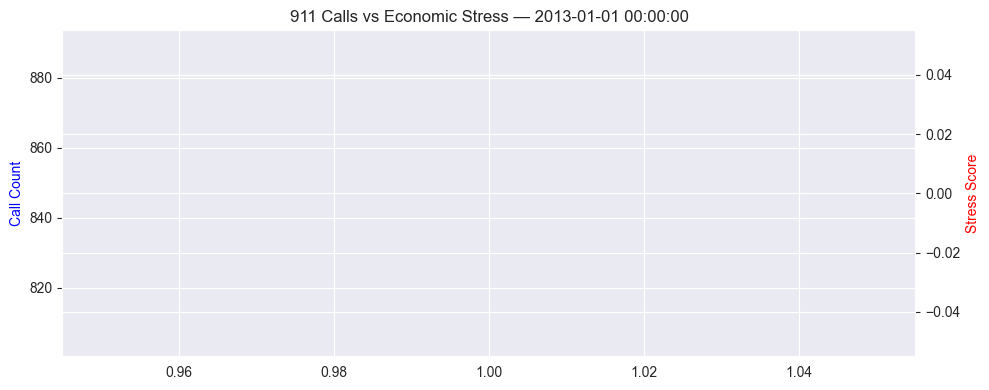

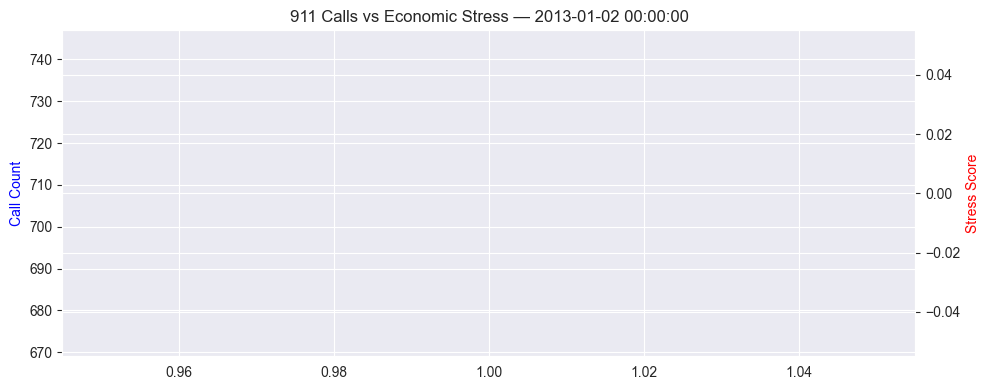

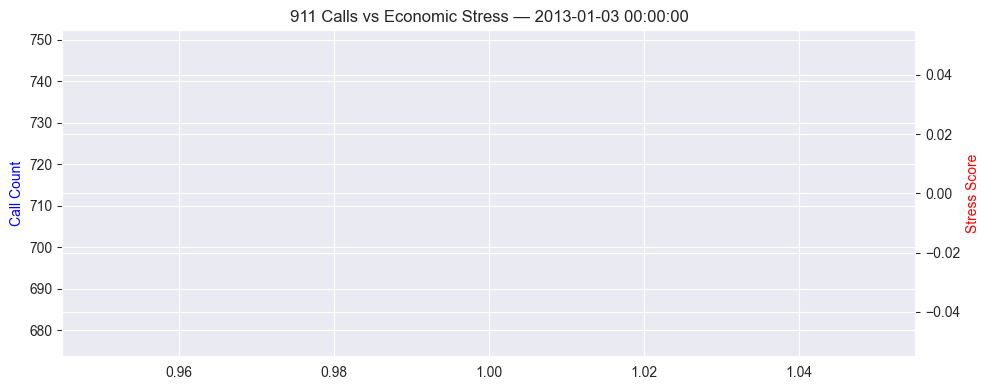

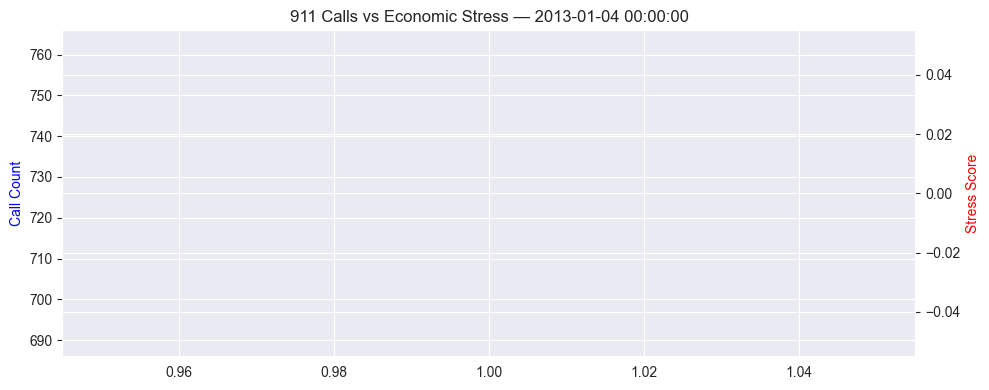

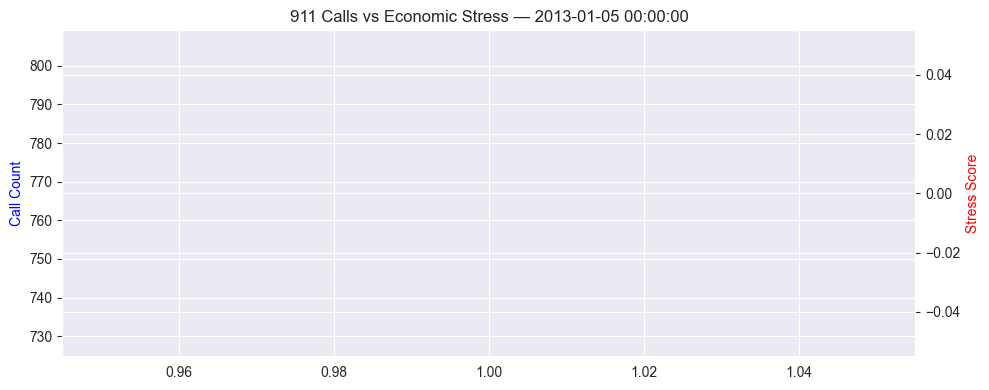

...

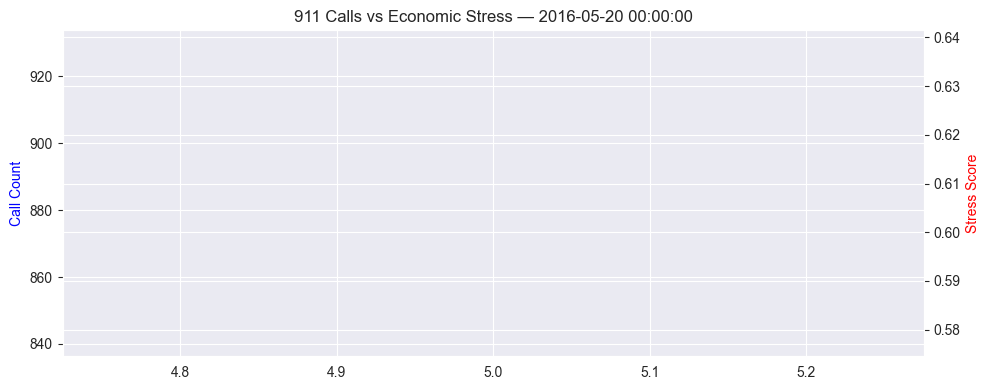

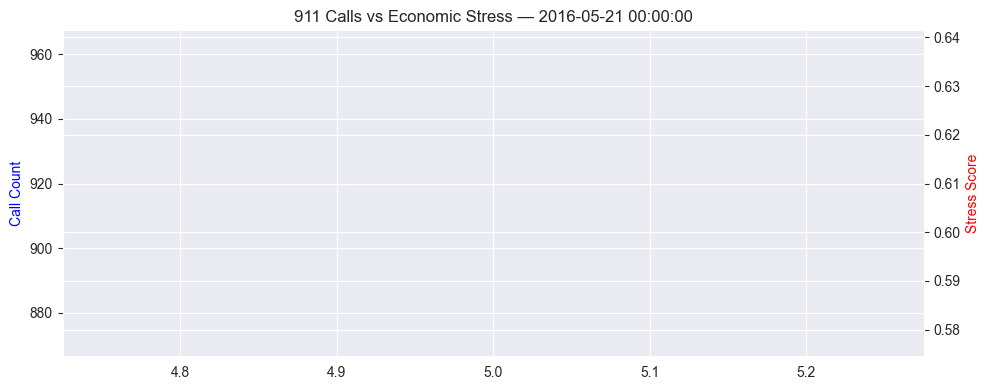

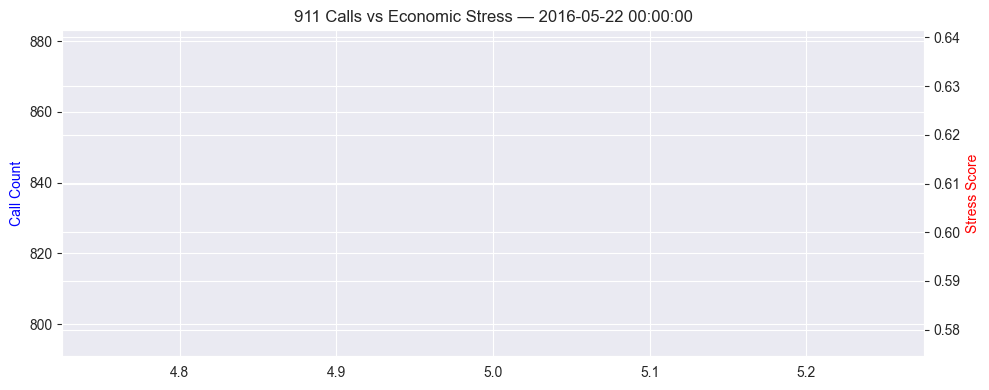

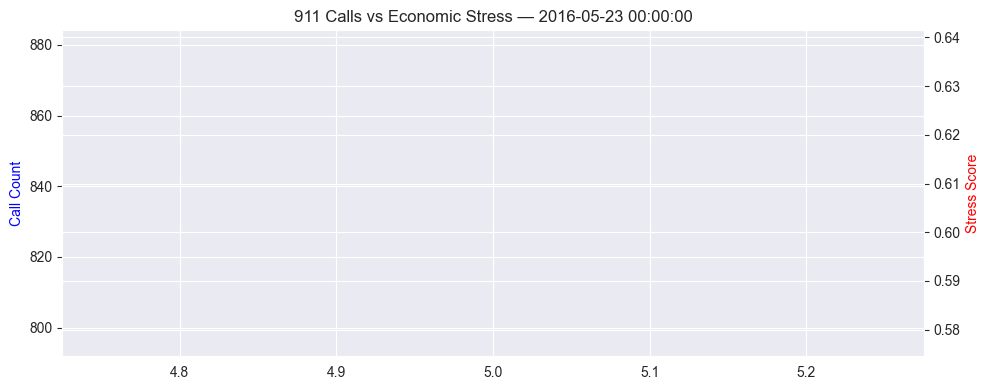

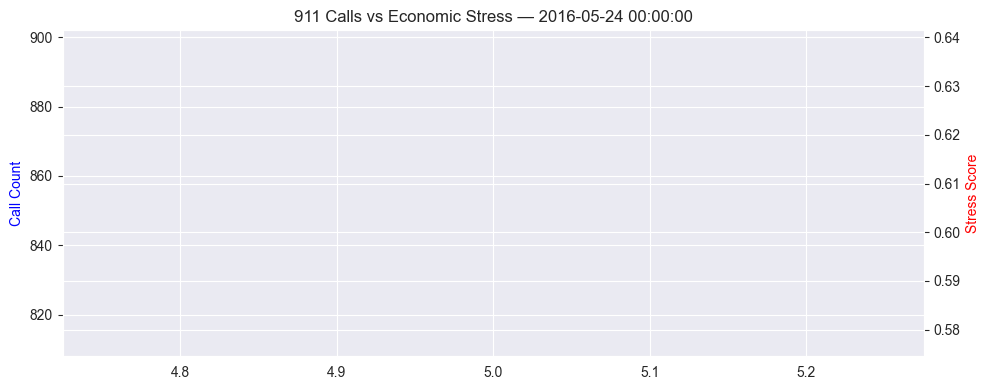

In [ ]:
import matplotlib.pyplot as plt

years = final_df['Year'].unique()
for year in years:
    subset = final_df[final_df['Year'] == year]
    fig, ax1 = plt.subplots(figsize=(10, 4))

    ax1.plot(subset['Month_Num'], subset['Call_Count'], color='blue', label='911 Calls')
    ax1.set_ylabel("Call Count", color='blue')
    ax1.set_title(f"911 Calls vs Economic Stress — {year}")

    ax2 = ax1.twinx()
    ax2.plot(subset['Month_Num'], subset['Stress_Score'], color='red', linestyle='--', label='Stress Score')
    ax2.set_ylabel("Stress Score", color='red')

    plt.grid(True)
    fig.tight_layout()
    plt.show()

